1. Dataset einlesen

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import folium


In [3]:
url = "https://docs.google.com/spreadsheets/d/1ecopK6oyyb4d_7-QLrCr8YlgFrCetHU7-VQfnYej7JY/export?format=xlsx"
dataset = pd.ExcelFile(url, engine='openpyxl')

sheets = []
for sheet in dataset.sheet_names:
    df = dataset.parse(sheet)
    df["City"] = sheet #adding a column to track from which group is the data
    sheets.append(df)

df = pd.concat(sheets, ignore_index=True)

In [4]:
df[["City", "days"]] = df["City"].str.split("_", expand=True)

In [5]:
df

,Unnamed: 0,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,...,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days
0,0,194.033698,Private room,False,True,2,False,1,0,10,...,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays
1,1,344.245776,Private room,False,True,4,False,0,0,8,...,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays
2,2,264.101422,Private room,False,True,2,False,0,1,9,...,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays
3,3,433.529398,Private room,False,True,4,False,0,1,9,...,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays
4,4,485.552926,Private room,False,True,2,True,0,0,10,...,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51702,1794,715.938574,Entire home/apt,False,False,6,False,0,1,10,...,0.530181,0.135447,219.402478,15.712158,438.756874,10.604584,16.37940,48.21136,vienna,weekends
51703,1795,304.793960,Entire home/apt,False,False,2,False,0,0,8,...,0.810205,0.100839,204.970121,14.678608,342.182813,8.270427,16.38070,48.20296,vienna,weekends
51704,1796,637.168969,Entire home/apt,False,False,2,False,0,0,10,...,0.994051,0.202539,169.073402,12.107921,282.296424,6.822996,16.38568,48.20460,vienna,weekends
51705,1797,301.054157,Private room,False,True,2,False,0,0,10,...,3.044100,0.287435,109.236574,7.822803,158.563398,3.832416,16.34100,48.19200,vienna,weekends


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51707 entries, 0 to 51706
Data columns (total 22 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Unnamed: 0                  51707 non-null  int64  
 1   realSum                     51707 non-null  float64
 2   room_type                   51707 non-null  object 
 3   room_shared                 51707 non-null  bool   
 4   room_private                51707 non-null  bool   
 5   person_capacity             51707 non-null  int64  
 6   host_is_superhost           51707 non-null  bool   
 7   multi                       51707 non-null  int64  
 8   biz                         51707 non-null  int64  
 9   cleanliness_rating          51707 non-null  int64  
 10  guest_satisfaction_overall  51707 non-null  int64  
 11  bedrooms                    51707 non-null  int64  
 12  dist                        51707 non-null  float64
 13  metro_dist                  517

2. Basic Cleaning

## Add column for country

In [7]:
df["City"].unique()

array(['amsterdam', 'athens', 'berlin', 'barcelona', 'budapest', 'lisbon',
       'london', 'paris', 'rome', 'vienna'], dtype=object)

In [8]:
# map cities to countries
city_to_country = {
    "amsterdam": "Netherlands",
    "athens": "Greece",
    "berlin": "Germany",
    "barcelona": "Spain",
    "budapest": "Hungary",
    "lisbon": "Portugal",
    "london": "United Kingdom",
    "paris": "France",
    "rome": "Italy",
    "vienna": "Austria"
}

# create new column
df["country"] = df["City"].map(city_to_country)

# test if it worked
print(df[["City", "country", "days"]].head())


        City      country      days
0  amsterdam  Netherlands  weekdays
1  amsterdam  Netherlands  weekdays
2  amsterdam  Netherlands  weekdays
3  amsterdam  Netherlands  weekdays
4  amsterdam  Netherlands  weekdays


In [9]:
df.head()

,Unnamed: 0,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,...,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days,country
0,0,194.033698,Private room,False,True,2,False,1,0,10,...,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,Netherlands
1,1,344.245776,Private room,False,True,4,False,0,0,8,...,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,Netherlands
2,2,264.101422,Private room,False,True,2,False,0,1,9,...,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,Netherlands
3,3,433.529398,Private room,False,True,4,False,0,1,9,...,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,Netherlands
4,4,485.552926,Private room,False,True,2,True,0,0,10,...,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,Netherlands


In [10]:
df["country"].describe()

count              51707
unique                10
top       United Kingdom
freq                9993
Name: country, dtype: object

## change column name

In [11]:
# rename column realSum in Price
df = df.rename(columns={"realSum": "Price"})

# test if it worked
print(df.columns)


Index(['Unnamed: 0', 'Price', 'room_type', 'room_shared', 'room_private',
       'person_capacity', 'host_is_superhost', 'multi', 'biz',
       'cleanliness_rating', 'guest_satisfaction_overall', 'bedrooms', 'dist',
       'metro_dist', 'attr_index', 'attr_index_norm', 'rest_index',
       'rest_index_norm', 'lng', 'lat', 'City', 'days', 'country'],
      dtype='object')


In [12]:
df.head()

,Unnamed: 0,Price,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,...,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days,country
0,0,194.033698,Private room,False,True,2,False,1,0,10,...,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,Netherlands
1,1,344.245776,Private room,False,True,4,False,0,0,8,...,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,Netherlands
2,2,264.101422,Private room,False,True,2,False,0,1,9,...,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,Netherlands
3,3,433.529398,Private room,False,True,4,False,0,1,9,...,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,Netherlands
4,4,485.552926,Private room,False,True,2,True,0,0,10,...,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,Netherlands


In [13]:
# delete first column
df = df.drop(df.columns[0], axis=1)

# test if it worked
print(df.columns)


Index(['Price', 'room_type', 'room_shared', 'room_private', 'person_capacity',
       'host_is_superhost', 'multi', 'biz', 'cleanliness_rating',
       'guest_satisfaction_overall', 'bedrooms', 'dist', 'metro_dist',
       'attr_index', 'attr_index_norm', 'rest_index', 'rest_index_norm', 'lng',
       'lat', 'City', 'days', 'country'],
      dtype='object')


In [14]:
df.head()

,Price,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,...,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days,country
0,194.033698,Private room,False,True,2,False,1,0,10,93,...,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,Netherlands
1,344.245776,Private room,False,True,4,False,0,0,8,85,...,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,Netherlands
2,264.101422,Private room,False,True,2,False,0,1,9,87,...,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,Netherlands
3,433.529398,Private room,False,True,4,False,0,1,9,90,...,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,Netherlands
4,485.552926,Private room,False,True,2,True,0,0,10,98,...,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,Netherlands


# Advanced Cleaning

The Step: "Instead of having two columns of room_shared and room_private, create one with the respective categories." is not clear to me. There is already the variable room_type, which kind of makes room_shared and rooom_private redundant. The research paper states that those are dummy variables. Why cant we just drop them both?

Delete the dummy variables for the number of listings of each host:

In [15]:
# create new colomn "host_portfolio"
# "one" if multi and biz are both 0
df["host_portfolio"] = "one"

# If multi is 1, the host has two to four listings
df.loc[df["multi"] == 1, "host_portfolio"] = "two_to_four"

# If biz is 1, the host has more than four listings
df.loc[df["biz"] == 1, "host_portfolio"] = "more_than_four"

# test if it worked
print(df["host_portfolio"].value_counts())


host_portfolio
one               18534
more_than_four    18108
two_to_four       15065
Name: count, dtype: int64


In [16]:
# delete dummys
df = df.drop(columns=["multi", "biz"])
print(df.columns)


Index(['Price', 'room_type', 'room_shared', 'room_private', 'person_capacity',
       'host_is_superhost', 'cleanliness_rating', 'guest_satisfaction_overall',
       'bedrooms', 'dist', 'metro_dist', 'attr_index', 'attr_index_norm',
       'rest_index', 'rest_index_norm', 'lng', 'lat', 'City', 'days',
       'country', 'host_portfolio'],
      dtype='object')


In [17]:
# download the dataset to check if everything is correct
df.to_csv("airbnb_cleaned.csv", index=False)



In [18]:
df.head(7)


,Price,room_type,room_shared,room_private,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,...,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days,country,host_portfolio
0,194.033698,Private room,False,True,2,False,10,93,1,5.022964,...,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,Netherlands,two_to_four
1,344.245776,Private room,False,True,4,False,8,85,1,0.488389,...,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,Netherlands,one
2,264.101422,Private room,False,True,2,False,9,87,1,5.748312,...,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,Netherlands,more_than_four
3,433.529398,Private room,False,True,4,False,9,90,2,0.384862,...,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,Netherlands,more_than_four
4,485.552926,Private room,False,True,2,True,10,98,1,0.544738,...,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,Netherlands,one
5,552.808567,Private room,False,True,3,False,8,100,2,2.131420,...,174.788957,9.255191,225.201662,15.692376,4.87699,52.38966,amsterdam,weekdays,Netherlands,one
6,215.124317,Private room,False,True,2,False,10,94,1,1.881092,...,200.167652,10.599010,242.765524,16.916251,4.91570,52.38296,amsterdam,weekdays,Netherlands,one


In [19]:
df.tail(7)


,Price,room_type,room_shared,room_private,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,...,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days,country,host_portfolio
51700,115.933899,Private room,False,True,4,False,9,94,1,3.041932,...,109.751387,7.859670,208.517887,5.039797,16.33970,48.19325,vienna,weekends,Austria,two_to_four
51701,750.765491,Entire home/apt,False,False,6,False,10,96,3,0.378804,...,257.494817,18.440080,548.973296,13.268473,16.37825,48.21001,vienna,weekends,Austria,more_than_four
51702,715.938574,Entire home/apt,False,False,6,False,10,100,3,0.530181,...,219.402478,15.712158,438.756874,10.604584,16.37940,48.21136,vienna,weekends,Austria,more_than_four
51703,304.793960,Entire home/apt,False,False,2,False,8,86,1,0.810205,...,204.970121,14.678608,342.182813,8.270427,16.38070,48.20296,vienna,weekends,Austria,one
51704,637.168969,Entire home/apt,False,False,2,False,10,93,1,0.994051,...,169.073402,12.107921,282.296424,6.822996,16.38568,48.20460,vienna,weekends,Austria,one
51705,301.054157,Private room,False,True,2,False,10,87,1,3.044100,...,109.236574,7.822803,158.563398,3.832416,16.34100,48.19200,vienna,weekends,Austria,one
51706,133.230489,Private room,False,True,4,True,10,93,1,1.263932,...,150.450381,10.774264,225.247293,5.444140,16.39066,48.20811,vienna,weekends,Austria,two_to_four


In [20]:
df.sample(7)

,Price,room_type,room_shared,room_private,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,...,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days,country,host_portfolio
28584,706.037301,Entire home/apt,False,False,4,False,8,88,2,2.763111,...,382.220613,26.569645,853.759443,15.280806,-0.09962,51.52604,london,weekends,United Kingdom,two_to_four
39477,211.114488,Entire home/apt,False,False,6,False,9,90,2,3.547376,...,316.889418,7.022332,932.233036,20.297338,12.48108,41.87313,rome,weekdays,Italy,one
31341,362.191020,Private room,False,True,4,False,10,100,1,4.252443,...,286.468711,19.913557,647.612785,11.591140,-0.18612,51.51943,london,weekends,United Kingdom,two_to_four
12332,208.299393,Private room,False,True,4,False,9,90,1,4.166831,...,367.782901,14.200523,345.666405,7.593130,2.12109,41.37999,barcelona,weekends,Spain,one
17557,333.255159,Entire home/apt,False,False,6,False,8,80,2,1.891220,...,127.883402,4.221979,367.012900,16.414186,-9.15933,38.71960,lisbon,weekdays,Portugal,more_than_four
50348,237.711240,Entire home/apt,False,False,2,True,9,93,1,2.771951,...,87.167014,6.242326,122.384527,2.957987,16.40188,48.19222,vienna,weekends,Austria,more_than_four
42239,380.380146,Entire home/apt,False,False,4,False,10,100,1,2.276770,...,611.307822,13.546702,1656.384175,36.064146,12.47705,41.90898,rome,weekdays,Italy,two_to_four


In [21]:
df.dtypes

Price                         float64
room_type                      object
room_shared                      bool
room_private                     bool
person_capacity                 int64
host_is_superhost                bool
cleanliness_rating              int64
guest_satisfaction_overall      int64
bedrooms                        int64
dist                          float64
metro_dist                    float64
attr_index                    float64
attr_index_norm               float64
rest_index                    float64
rest_index_norm               float64
lng                           float64
lat                           float64
City                           object
days                           object
country                        object
host_portfolio                 object
dtype: object

In [22]:
df.describe(include="object")

,room_type,City,days,country,host_portfolio
count,51707,51707,51707,51707,51707
unique,3,10,2,10,3
top,Entire home/apt,london,weekends,United Kingdom,one
freq,32648,9993,26207,9993,18534


In [23]:
df.describe ()

,Price,person_capacity,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat
count,51707.000000,51707.000000,51707.000000,51707.000000,51707.00000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000
mean,279.879591,3.161661,9.390624,92.628232,1.15876,3.191285,0.681540,294.204105,13.423792,626.856696,22.786177,7.426068,45.671128
std,327.948386,1.298545,0.954868,8.945531,0.62741,2.393803,0.858023,224.754123,9.807985,497.920226,17.804096,9.799725,5.249263
min,34.779339,2.000000,2.000000,20.000000,0.00000,0.015045,0.002301,15.152201,0.926301,19.576924,0.592757,-9.226340,37.953000
25%,148.752174,2.000000,9.000000,90.000000,1.00000,1.453142,0.248480,136.797385,6.380926,250.854114,8.751480,-0.072500,41.399510
50%,211.343089,3.000000,10.000000,95.000000,1.00000,2.613538,0.413269,234.331748,11.468305,522.052783,17.542238,4.873000,47.506690
75%,319.694287,4.000000,10.000000,99.000000,1.00000,4.263077,0.737840,385.756381,17.415082,832.628988,32.964603,13.518825,51.471885
max,18545.450285,6.000000,10.000000,100.000000,10.00000,25.284557,14.273577,4513.563486,100.000000,6696.156772,100.000000,23.786020,52.641410


In [24]:
total_listing = df['City'].value_counts()
total_listing

City
london       9993
rome         9027
paris        6688
lisbon       5763
athens       5280
budapest     4022
vienna       3537
barcelona    2833
berlin       2484
amsterdam    2080
Name: count, dtype: int64

In [25]:
listing_by_day = df.groupby(['City', 'days']).size().reset_index(name='count')
listing_by_day

,City,days,count
0,amsterdam,weekdays,1103
1,amsterdam,weekends,977
2,athens,weekdays,2653
3,athens,weekends,2627
4,barcelona,weekdays,1555
5,barcelona,weekends,1278
6,berlin,weekdays,1284
7,berlin,weekends,1200
8,budapest,weekdays,2074
9,budapest,weekends,1948


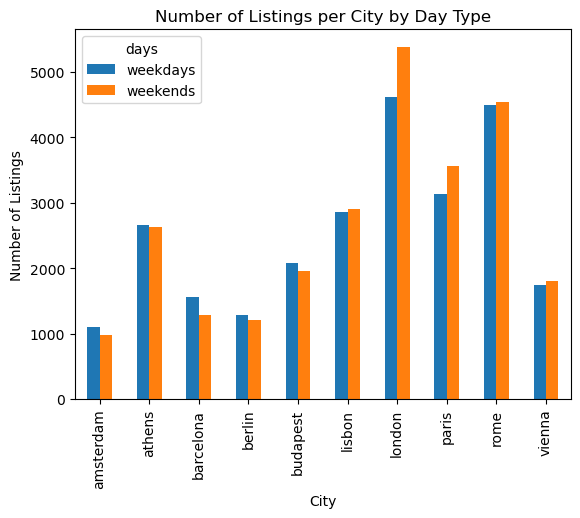

In [26]:
# Bar chart for listings per city and day type
listing_by_day.pivot(index='City', columns='days', values='count').plot(kind='bar')
plt.title('Number of Listings per City by Day Type')
plt.ylabel('Number of Listings')
plt.show()


In [27]:
Proposition = df.groupby('City')['host_is_superhost'].mean().sort_values(ascending=False)
Proposition

City
athens       0.428598
budapest     0.378916
rome         0.326687
vienna       0.284139
amsterdam    0.284135
berlin       0.257246
lisbon       0.213951
barcelona    0.181433
london       0.157410
paris        0.140700
Name: host_is_superhost, dtype: float64

<Axes: title={'center': 'Proportion of Superhosts by City'}, xlabel='City', ylabel='Proportion'>

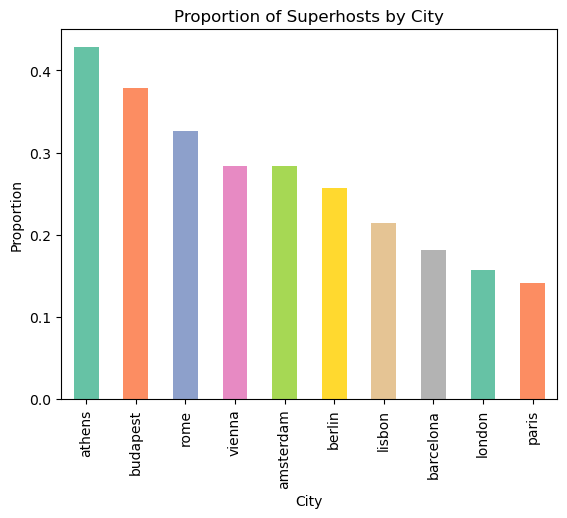

In [28]:
Proposition.plot(kind='bar', title='Proportion of Superhosts by City', ylabel='Proportion', color=plt.cm.Set2.colors, xlabel='City')

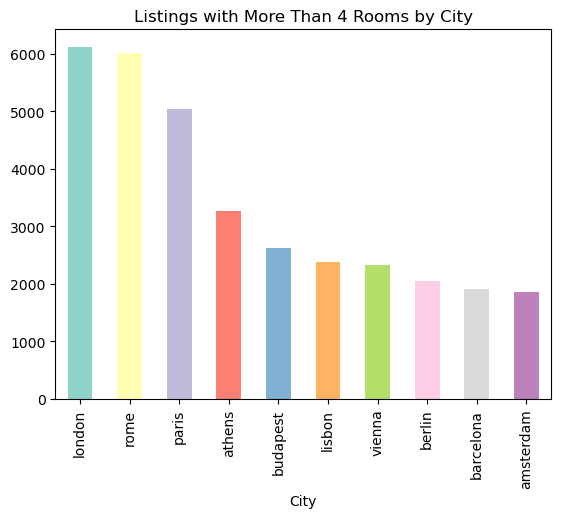

In [29]:
MF4 = df[df['host_portfolio'] > "more_than_four" ]['City'].value_counts().plot(kind='bar', color=plt.cm.Set3.colors, title='Listings with More Than 4 Rooms by City')

In [30]:
Entire_home = df[df['room_type'] == 'Entire home/apt']['City'].value_counts()
Entire_home

City
rome         5561
paris        5067
athens       4872
london       4384
lisbon       3878
budapest     3589
vienna       2747
amsterdam    1126
berlin        882
barcelona     542
Name: count, dtype: int64

<Axes: title={'center': 'Entire Home Listings by City'}, xlabel='City'>

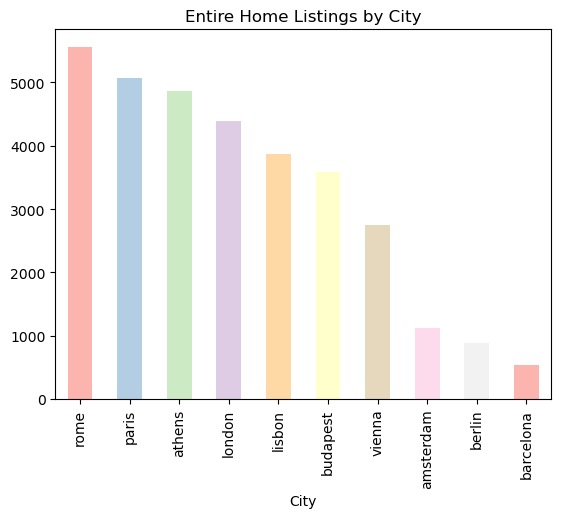

In [31]:
Entire_home.plot(kind='bar', color=plt.cm.Pastel1.colors, title='Entire Home Listings by City')

Text(0, 0.5, 'Number of Listings')

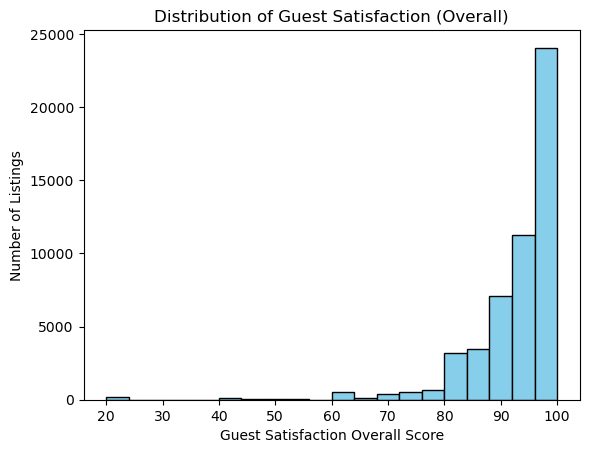

In [32]:
df['guest_satisfaction_overall'].plot(kind='hist', bins=20, color='skyblue', title='Distribution of Guest Satisfaction (Overall)', edgecolor='black')
plt.xlabel('Guest Satisfaction Overall Score')
plt.ylabel('Number of Listings')

In [33]:
df['guest_satisfaction_overall'].describe()

count    51707.000000
mean        92.628232
std          8.945531
min         20.000000
25%         90.000000
50%         95.000000
75%         99.000000
max        100.000000
Name: guest_satisfaction_overall, dtype: float64

Text(0, 0.5, 'Number of Listings')

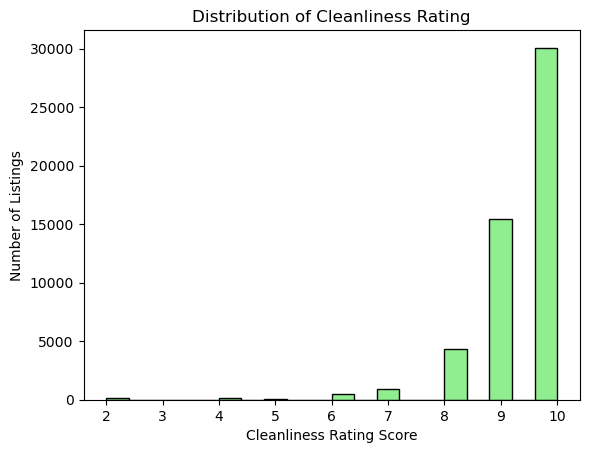

In [34]:
df['cleanliness_rating'].plot(kind='hist', bins=20, color='lightgreen', title='Distribution of Cleanliness Rating', edgecolor='black')
plt.xlabel('Cleanliness Rating Score')
plt.ylabel('Number of Listings')

In [35]:
df['cleanliness_rating'].describe()

count    51707.000000
mean         9.390624
std          0.954868
min          2.000000
25%          9.000000
50%         10.000000
75%         10.000000
max         10.000000
Name: cleanliness_rating, dtype: float64

Text(0.5, 0, 'Person Capacity')

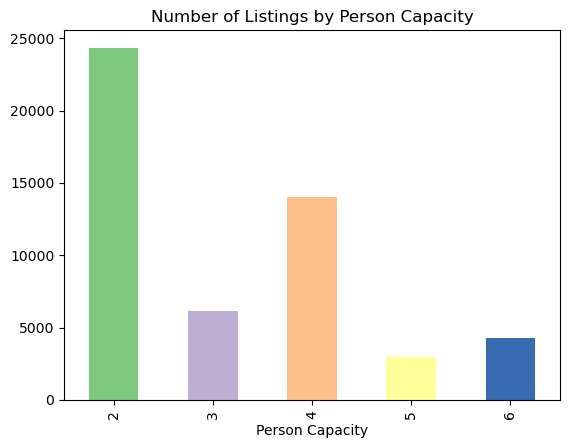

In [36]:
df['person_capacity'].describe()
capacity_counts = df['person_capacity'].value_counts().sort_index()
capacity_counts.plot(kind='bar', color=plt.cm.Accent.colors, title='Number of Listings by Person Capacity')
plt.xlabel('Person Capacity')           

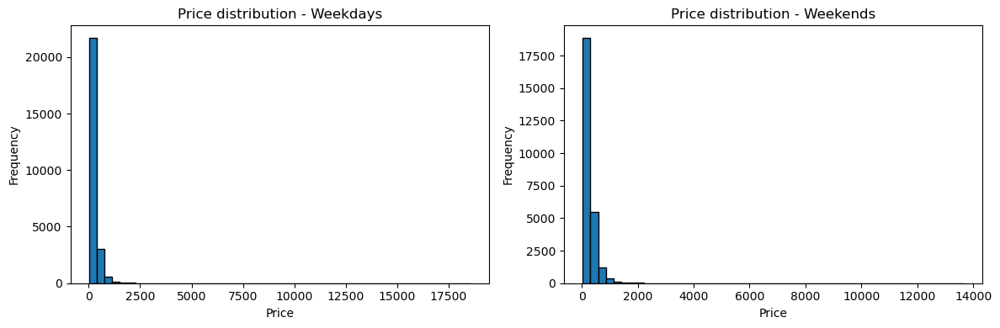

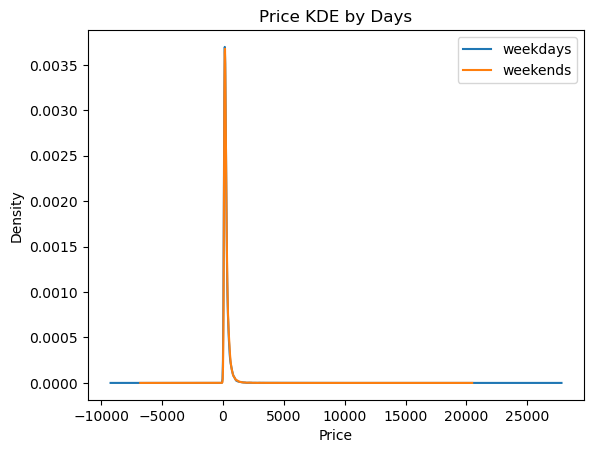

In [37]:
# histograms side-by-side
fig, axes = plt.subplots(1,2, figsize=(12,4))
df[df['days']=='weekdays']['Price'].plot(kind='hist', bins=50, ax=axes[0], edgecolor='black')
axes[0].set_title('Price distribution - Weekdays')
axes[0].set_xlabel('Price')

df[df['days']=='weekends']['Price'].plot(kind='hist', bins=50, ax=axes[1], edgecolor='black')
axes[1].set_title('Price distribution - Weekends')
axes[1].set_xlabel('Price')
plt.tight_layout()
plt.show()

# KDEs overlapping
df.groupby('days')['Price'].plot(kind='kde', legend=True)
plt.title('Price KDE by Days')
plt.xlabel('Price')
plt.show()

### Does the price per night tend to be higher on weekends?


In [38]:
df.head()

,Price,room_type,room_shared,room_private,person_capacity,host_is_superhost,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,...,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,City,days,country,host_portfolio
0,194.033698,Private room,False,True,2,False,10,93,1,5.022964,...,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,amsterdam,weekdays,Netherlands,two_to_four
1,344.245776,Private room,False,True,4,False,8,85,1,0.488389,...,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,amsterdam,weekdays,Netherlands,one
2,264.101422,Private room,False,True,2,False,9,87,1,5.748312,...,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,amsterdam,weekdays,Netherlands,more_than_four
3,433.529398,Private room,False,True,4,False,9,90,2,0.384862,...,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,amsterdam,weekdays,Netherlands,more_than_four
4,485.552926,Private room,False,True,2,True,10,98,1,0.544738,...,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,amsterdam,weekdays,Netherlands,one


In [39]:
# Run df describe to see data grouped for day type and city
df.groupby(['City', 'days'])['Price'].describe()



count        mean         std         min         25%  \
City      days                                                               
amsterdam weekdays  1103.0  545.020526  416.974314  128.887118  309.797764   
          weekends   977.0  604.828018  443.682821  165.912872  362.758653   
athens    weekdays  2653.0  155.866982  366.573124   42.884259   99.594591   
          weekends  2627.0  147.580456   79.814934   42.884259   98.657231   
barcelona weekdays  1555.0  288.391667  321.180435   69.588289  161.984779   
          weekends  1278.0  300.277940  393.207126   80.992390  159.657412   
berlin    weekdays  1284.0  240.220422  230.318175   64.971487  143.731887   
          weekends  1200.0  249.252516  240.584178   64.971487  147.237543   
budapest  weekdays  2074.0  168.429367  126.059120   37.129295  122.432674   
          weekends  1948.0  185.120628  135.855683   34.779339  128.248813   
lisbon    weekdays  2857.0  236.345459  108.463770   70.825516  160.178236   
          weekends  2906.0  240.044051  109.459172   70.590994  161.819887   
london    weekdays  4614.0  360.230348  507.782888   64.676968  167.454550   
          weekends  5379.0  364.389747  437.742534   54.328653  174.510219   
paris     weekdays  3130.0  398.786678  396.367985   92.739305  240.003728   
          weekends  3558.0  387.028589  260.075100   95.302451  240.994035   
rome      weekdays  4492.0  201.618053  117.749372   46.057092  136.067145   
          weekends  4535.0  209.130063  119.367764   46.057092  138.638861   
vienna    weekdays  1738.0  240.384834  454.526276   69.653834  162.213963   
          weekends  1799.0  242.739524  333.973791   63.576654  165.135685   

                           50%         75%           max  
City      days                                            
amsterdam weekdays  430.248635  657.324303   7782.907225  
          weekends  491.645771  716.612378   8130.668104  
athens    weekdays  127.715417  171.537037  18545.450285  
          weekends  127.715417  171.537037   1043.282638  
barcelona weekdays  208.532129  335.373659   6943.700980  
          weekends  204.691973  327.169688   6942.770033  
berlin    weekdays  187.786295  277.005235   5857.483407  
          weekends  192.460503  286.762644   5856.081144  
budapest  weekdays  147.459698  184.941486   3630.681017  
          weekends  160.031959  208.969780   3751.233727  
lisbon    weekdays  223.030019  284.005629   1681.050657  
          weekends  227.720450  289.340994   1188.086304  
london    weekdays  256.355982  435.452386  15499.894165  
          weekends  268.115431  438.274654  12937.275101  
paris     weekdays  318.529220  463.463510  16445.614689  
          weekends  316.199087  461.133377   4188.414577  
rome      weekdays  179.786314  235.195100   2418.348023  
          weekends  184.462161  242.676455   2311.738714  
vienna    weekdays  204.520487  266.636281  13664.305916  
          weekends  212.000093  280.017764  13656.358834

The median prices for weekends are higher than weekdays in many cities but not all.

# Are listings of super hosts more expensive than those of normal hosts?

In [40]:
df.groupby(['host_is_superhost'])['Price'].describe()


,count,mean,std,min,25%,50%,75%,max
host_is_superhost,,,,,,,,
False,38475.0,288.625905,334.341668,34.779339,150.328478,217.549801,334.427767,16445.614689
True,13232.0,254.447726,307.207550,45.227662,143.748685,197.040881,282.635011,18545.450285


In [41]:
from scipy.stats import mannwhitneyu

# Split data
superhost_prices = df[df['host_is_superhost'] == True]['Price'].dropna()
normalhost_prices = df[df['host_is_superhost'] == False]['Price'].dropna()

# Run the test (one-sided: superhost > normal)
stat, p_value = mannwhitneyu(
    superhost_prices,
    normalhost_prices,
    alternative='greater'
)

# Display results
print("Mann–Whitney U statistic:", stat)
print("p-value:", p_value)
print("Median superhost:", round(superhost_prices.median(), 2))
print("Median normal host:", round(normalhost_prices.median(), 2))
print("Mean superhost:", round(superhost_prices.mean(), 2))
print("Mean normal host:", round(normalhost_prices.mean(), 2))


Mann–Whitney U statistic: 230623961.5
p-value: 1.0
Median superhost: 197.04
Median normal host: 217.55
Mean superhost: 254.45
Mean normal host: 288.63


In [42]:
# Run the test the other way around to prove if there is significance for lower superhost prices
# Run the test (one-sided: normal > superhost)
stat, p_value = mannwhitneyu(
    normalhost_prices,
    superhost_prices,
    alternative='greater'
)

# Display results
print("Mann–Whitney U statistic:", stat)
print("p-value:", p_value)
print("Median superhost:", round(superhost_prices.median(), 2))
print("Median normal host:", round(normalhost_prices.median(), 2))
print("Mean superhost:", round(superhost_prices.mean(), 2))
print("Mean normal host:", round(normalhost_prices.mean(), 2))


Mann–Whitney U statistic: 278477238.5
p-value: 5.285064560589961e-59
Median superhost: 197.04
Median normal host: 217.55
Mean superhost: 254.45
Mean normal host: 288.63


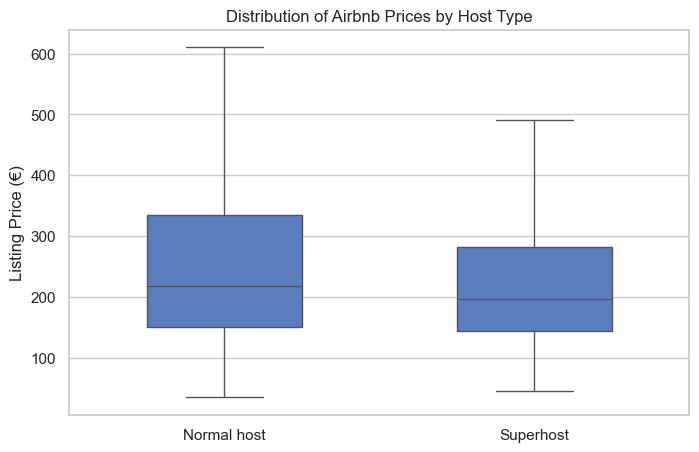

In [43]:
import seaborn as sns
import matplotlib.pyplot as plt

# Adjust style for better visuals
sns.set(style="whitegrid", palette="muted")

plt.figure(figsize=(8, 5))
sns.boxplot(
    data=df,
    x='host_is_superhost',
    y='Price',
    showfliers=False,  # hide extreme outliers for clearer comparison; prices of up tp 18.000 would render the scale usesless
    width=0.5
)

# Label axes and add title
plt.xticks([0, 1], ['Normal host', 'Superhost'])
plt.xlabel("")
# plt.yscale("log") not required
plt.ylabel("Listing Price (€)")
plt.title("Distribution of Airbnb Prices by Host Type")

plt.show()




**Answer:** Superhosts charge significantly less than normal hosts. Hypothesis: They are Superhosts because they rent out their properties often, suggesting that they are rather interested in acchieving a high utilization than high individual price.

# Are superhosts closer to the city center and metro station than normal hosts?

### Metro

In [44]:
df.groupby(['host_is_superhost'])['metro_dist'].describe()


,count,mean,std,min,25%,50%,75%,max
host_is_superhost,,,,,,,,
False,38475.0,0.681903,0.871487,0.002301,0.243546,0.406985,0.734231,14.273577
True,13232.0,0.680483,0.817646,0.010233,0.262765,0.433326,0.746356,9.286229


In [45]:
# Split data
superhost_metro_dist = df[df['host_is_superhost'] == True]['metro_dist'].dropna()
normalhost_metro_dist = df[df['host_is_superhost'] == False]['metro_dist'].dropna()

# Mann–Whitney U test (one-sided: normal host closer → smaller distance)
stat, p_value = mannwhitneyu(
    superhost_metro_dist,
    normalhost_metro_dist,   # note the order! since smaller = closer
    alternative='greater'  # tests if normal hosts are farther away
)

print("Meto Station distance test:")
print("Mann–Whitney U statistic:", stat)
print("p-value:", p_value)
print("Median superhost distance to Metro:", round(superhost_metro_dist.median(), 2))
print("Median normal host distance to Metro:", round(normalhost_metro_dist.median(), 2))


Meto Station distance test:
Mann–Whitney U statistic: 263778575.0
p-value: 2.3261970049534165e-10
Median superhost distance to Metro: 0.43
Median normal host distance to Metro: 0.41


**Answer:** Normal hosts are in median 20m closer to the metro with high significance

### City Center

In [46]:
df.groupby(['host_is_superhost'])['dist'].describe()


,count,mean,std,min,25%,50%,75%,max
host_is_superhost,,,,,,,,
False,38475.0,3.270057,2.410844,0.015045,1.506846,2.702721,4.361549,25.284557
True,13232.0,2.962239,2.328544,0.039814,1.321117,2.391335,3.961200,20.495678


In [47]:
# Split data
superhost_dist = df[df['host_is_superhost'] == True]['dist'].dropna()
normalhost_dist = df[df['host_is_superhost'] == False]['dist'].dropna()

# Mann–Whitney U test (one-sided: superhost closer to city center)
stat, p_value = mannwhitneyu(
    normalhost_dist,
    superhost_dist,
    alternative='greater'  # tests if normal hosts are farther away
)

print("City Center distance test:")
print("Mann–Whitney U statistic:", stat)
print("p-value:", p_value)
print("Median superhost distance to City Center:", round(superhost_dist.median(), 2))
print("Median normal host distance to City Center:", round(normalhost_dist.median(), 2))

City Center distance test:
Mann–Whitney U statistic: 276721448.0
p-value: 5.855844986157905e-51
Median superhost distance to City Center: 2.39
Median normal host distance to City Center: 2.7


**Answer:** Superhosts are closer to the city center by 10%. Hypothesis: This could be a sign of gentrification. Locals (tend to be more casuals hosts not super hosts) have properties that are further away from the city center. This becomes even more visible when comparing single property portfolios against commercial listing of hosts with >4 flats.

In [48]:
df.groupby(['host_portfolio'])['dist'].describe()


,count,mean,std,min,25%,50%,75%,max
host_portfolio,,,,,,,,
more_than_four,18108.0,2.654029,2.009455,0.039814,1.180556,2.180431,3.695760,18.511822
one,18534.0,3.614762,2.555262,0.015045,1.801006,3.059358,4.744582,22.617458
two_to_four,15065.0,3.316072,2.489785,0.076165,1.478199,2.727484,4.473867,25.284557


In [49]:
comm_dist = df[df['host_portfolio'] == 'more_than_four']['dist'].dropna()
priv_dist = df[df['host_portfolio'] == 'one']['dist'].dropna()

# Mann–Whitney U test (one-sided: commercial host closer to city center)
stat, p_value = mannwhitneyu(
    priv_dist,
    comm_dist,
    alternative='greater'
)
print("City Center distance test Commercial vs. Private:")
print("Mann–Whitney U statistic:", stat)
print("p-value:", p_value)
print("Median superhost distance to City Center:", round(comm_dist.median(), 2))
print("Median normal host distance to City Center:", round(priv_dist.median(), 2))

City Center distance test Commercial vs. Private:
Mann–Whitney U statistic: 209326434.0
p-value: 0.0
Median superhost distance to City Center: 2.18
Median normal host distance to City Center: 3.06


**hint:** strong sign for gentrification

# Geo Analysis (Chatty helped here)

In [50]:
city_center = [52.5200, 13.4050]  # Berlin coordinates
m = folium.Map(location=city_center, zoom_start=12, tiles='cartodb positron')


In [51]:
# Function to choose color by host portfolio
def portfolio_color(portfolio):
    if portfolio == 'one':
        return 'blue'          # private host
    elif portfolio == 'two_to_four':
        return 'orange'        # small portfolio
    elif portfolio == 'more_than_four':
        return 'red'           # commercial
    else:
        return 'gray'

In [52]:
# Subset your dataframe to relevant columns and drop missing coordinates
# Full Dataset, map is centered around Berlin; Can be moved to different places however (Paris and London are interesting)
subset = df[['lat', 'lng', 'host_portfolio']].dropna()

for _, row in subset.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lng']],
        radius=3,
        color=portfolio_color(row['host_portfolio']),
        fill=True,
        fill_opacity=0.6,
        weight=0,
    ).add_to(m)


In [53]:
m

In [54]:
import matplotlib.pyplot as plt

# 1) Set up the figure
plt.figure(figsize=(10, 6))

# 2) Create the boxplot
# 'showfliers=False' hides the outliers
# 'patch_artist=True' allows colored boxes
box = plt.boxplot(
    [df[df["city"] == city]["Price"] for city in df["city"].unique()],
    labels=df["city"].unique(),
    patch_artist=True,
    showfliers=False
)

# 3) Assign a different color to each city
colors = plt.cm.tab10.colors  # 10 nice distinct colors
for patch, color in zip(box["boxes"], colors):
    patch.set_facecolor(color)

# 4) Add title and labels
plt.title("Airbnb Prices by City", fontsize=14)
plt.xlabel("City", fontsize=12)
plt.ylabel("Price (EUR)", fontsize=12)

# 5) Rotate x-labels for readability
plt.xticks(rotation=45)

# 6) Display the plot
plt.tight_layout()
plt.show()


KeyError: 'city'

<Figure size 1000x600 with 0 Axes>